In [118]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

plt.rcParams["animation.html"] = "jshtml"


In [119]:
%matplotlib inline
# Initial conditions and parameters
g = 9.81
l1, l2 = 1.0, 1.0
m1, m2 = 1.0, 1.0
dt = 0.001
T_max = 100
N = int(T_max / dt)
t = np.linspace(0, T_max, N)
y0 = np.radians([124.6, -10, 0, 0])

In [120]:


# Functions for dynamics
def alpha_1(theta_1, theta_2):
    return (l2/l1) * (m2/(m1 + m2)) * np.cos(theta_1 - theta_2)

def alpha_2(theta_1, theta_2):
    return (l1/l2) * np.cos(theta_1 - theta_2)

def f1(theta_1, theta_2, w2):
    return -(l2/l1) * (m2/(m1 + m2)) * (w2 ** 2) * np.sin(theta_1 - theta_2) - (g/l1) * np.sin(theta_1)

def f2(theta_1, theta_2, w1):
    return (l1/l2) * (w1 ** 2) * np.sin(theta_1 - theta_2) - (g/l2) * np.sin(theta_2)

def RK_term(t, y, dt, f):
    k1 = dt * f(y, t)
    k2 = dt * f(y + 0.5 * k1, t + 0.5 * dt)
    k3 = dt * f(y + 0.5 * k2, t + 0.5 * dt)
    k4 = dt * f(y + k3, t + dt)
    return (1/6) * (k1 + 2 * k2 + 2 * k3 + k4)

def domega(y, t):
    theta_1, theta_2, w1, w2 = y
    c = 1 / (1 - alpha_1(theta_1, theta_2) * alpha_2(theta_1, theta_2))
    g1 = c * (f1(theta_1, theta_2, w2) - alpha_1(theta_1, theta_2) * f2(theta_1, theta_2, w1))
    g2 = c * (f2(theta_1, theta_2, w1) - alpha_2(theta_1, theta_2) * f1(theta_1, theta_2, w2))
    return np.array([w1, w2, g1, g2])

def T_energy(point):
    theta_1, theta_2, w1, w2 = point
    T = 0.5 * (m1 + m2) * (l1 ** 2) * (w1 ** 2) + 0.5 * m2 * (l2 ** 2) * (w2 ** 2) + m2 * l1 * l2 * w1 * w2 * np.cos(theta_1 - theta_2)
    V = -(m1 + m2) * g * l1 * np.cos(theta_1) - m2 * g * l2 * np.cos(theta_2)
    return T + V

def RK_4_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + RK_term(t[i - 1], y[i - 1], dt, domega))
    total_energy_rk = np.array([T_energy(p) for p in y])
    return y, total_energy_rk

def Euler_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + dt * domega(y[i - 1], t[i - 1]))
    total_energy_eu = np.array([T_energy(p) for p in y])
    return y, total_energy_eu

In [121]:


rk_y, rk_E = RK_4_DP()
eu_y, eu_E = Euler_DP()

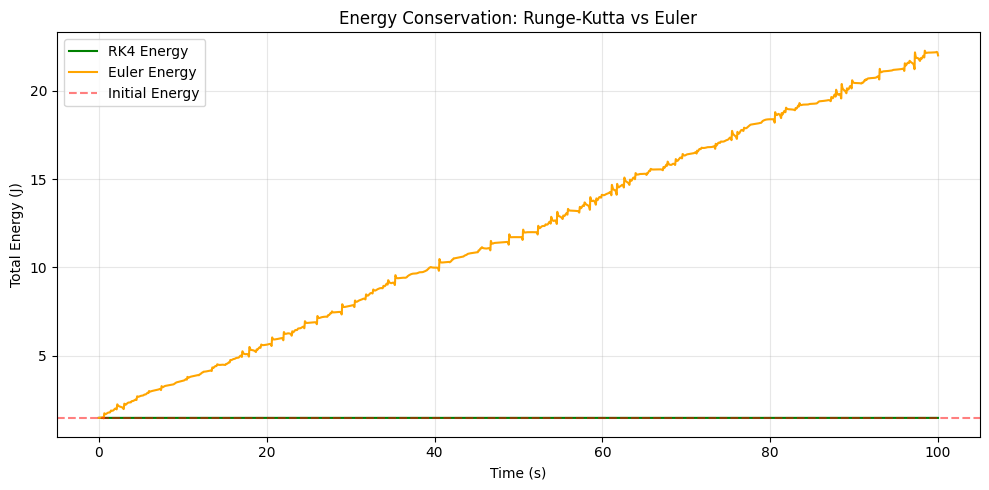

In [122]:


# Energy comparison
plt.figure(figsize=(10, 5))
plt.plot(t, rk_E, label="RK4 Energy", color='green')
plt.plot(t, eu_E, label="Euler Energy", color='orange')
plt.axhline(rk_E[0], linestyle='--', color='red', alpha=0.5, label="Initial Energy")
plt.title("Energy Conservation: Runge-Kutta vs Euler")
plt.xlabel("Time (s)")
plt.ylabel("Total Energy (J)")
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


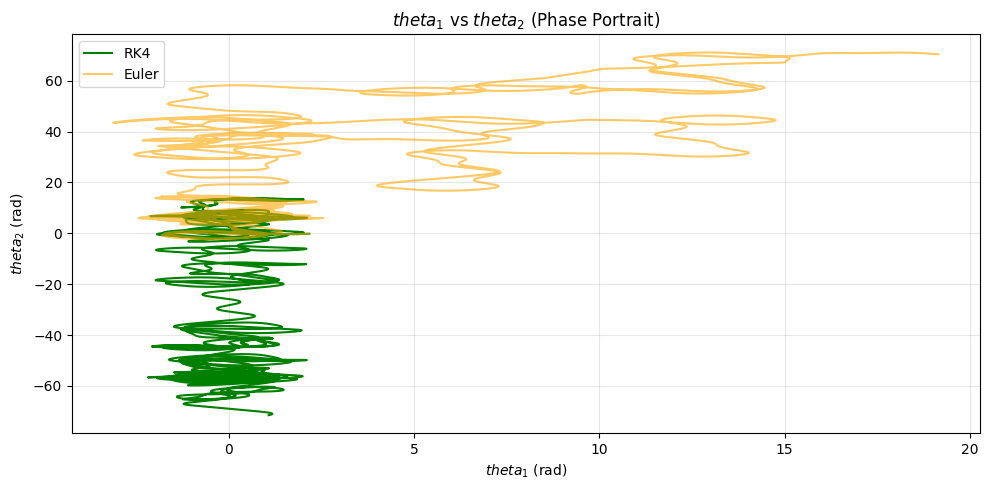

In [123]:

# Phase portraits
rk_theta_1 = np.array([s[0] for s in rk_y])
rk_theta_2 = np.array([s[1] for s in rk_y])
eu_theta_1 = np.array([s[0] for s in eu_y])
eu_theta_2 = np.array([s[1] for s in eu_y])

plt.figure(figsize=(10, 5))
plt.plot(rk_theta_1, rk_theta_2, label="RK4", color='green')
plt.plot(eu_theta_1, eu_theta_2, label="Euler", color='orange', alpha=0.6)
plt.title(r'$theta_1$ vs $theta_2$ (Phase Portrait)')
plt.xlabel(r'$theta_1$ (rad)')
plt.ylabel(r'$theta_2$ (rad)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

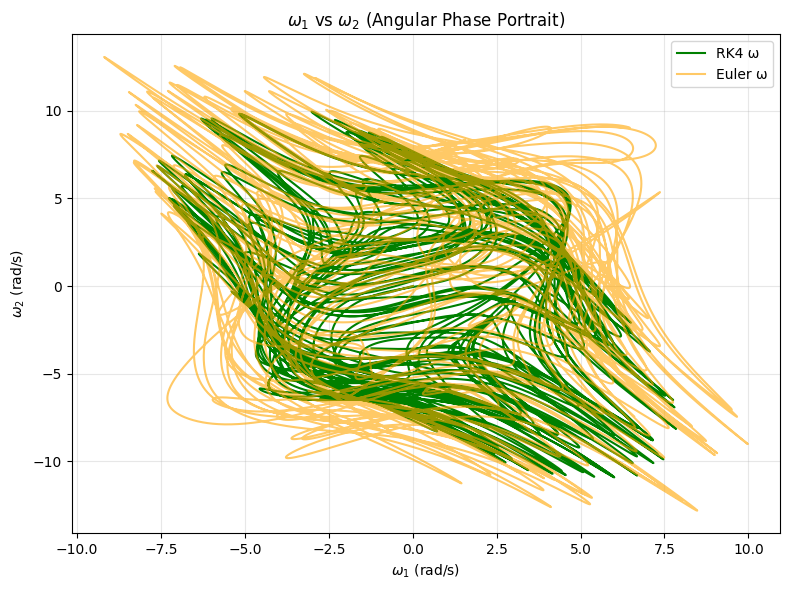

In [124]:
rk_omega_1 = np.array([state[2] for state in rk_y])
rk_omega_2 = np.array([state[3] for state in rk_y])
eu_omega_1 = np.array([state[2] for state in eu_y])
eu_omega_2 = np.array([state[3] for state in eu_y])

plt.figure(figsize=(8,6))
plt.plot(rk_omega_1, rk_omega_2, label="RK4 ω", color='green')
plt.plot(eu_omega_1, eu_omega_2, label="Euler ω", color='orange', alpha=0.6)
plt.title(r'$\omega_1$ vs $\omega_2$ (Angular Phase Portrait)')
plt.xlabel(r'$\omega_1$ (rad/s)')
plt.ylabel(r'$\omega_2$ (rad/s)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


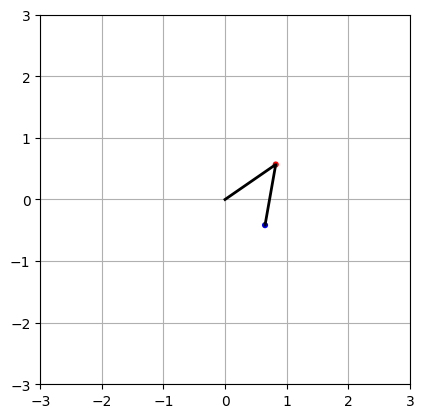

In [125]:
# Animation functions
def get_double_pendulum_coords(theta1, theta2):
    x1 = l1 * np.sin(theta1)
    y1 = -l1 * np.cos(theta1)
    x2 = x1 + l2 * np.sin(theta2)
    y2 = y1 - l2 * np.cos(theta2)
    return x1, y1, x2, y2

fig, ax = plt.subplots()
x1_0, y1_0, x2_0, y2_0 = get_double_pendulum_coords(rk_theta_1[0], rk_theta_2[0])
line, = ax.plot([0, x1_0, x2_0], [0, y1_0, y2_0], lw=2, c='k')
bob1 = ax.add_patch(plt.Circle((x1_0, y1_0), 0.05, fc='r'))
bob2 = ax.add_patch(plt.Circle((x2_0, y2_0), 0.05, fc='b'))

ax.set_xlim(-1.5*(l1+l2), 1.5*(l1+l2))
ax.set_ylim(-1.5*(l1+l2), 1.5*(l1+l2))
ax.set_aspect('equal')
ax.grid(True)

In [ ]:
def animate(i):
    x1, y1, x2, y2 = get_double_pendulum_coords(rk_theta_1[i], rk_theta_2[i])
    line.set_data([0, x1, x2], [0, y1, y2])
    bob1.set_center((x1, y1))
    bob2.set_center((x2, y2))
    return line, bob1, bob2

ani = animation.FuncAnimation(fig, animate, frames=len(rk_theta_1), interval=dt * 1000)

%matplotlib notebook
plt.rcParams["animation.html"] = "jshtml"
ani


Animation size has reached 20981940 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:

# rk4 with initial conditions

def RK_4_ini(y0_ini=None):
    if y0_ini is None:
        y0_ini = y0
    y = [y0_ini]
    for i in range(1, N):
        y.append(y[i - 1] + RK_term(t[i - 1], y[i - 1], dt, domega))
    return y, np.array([T_energy(p) for p in y])


In [ ]:

y0_a = np.radians([120, -10, 0, 0])
y0_b = np.radians([121.0001, -10, 0, 0])
rk_y_a, _ = RK_4_ini(y0_a)
rk_y_b, _ = RK_4_ini(y0_b)

theta1_a = np.array([s[0] for s in rk_y_a])
theta2_a = np.array([s[1] for s in rk_y_a])
theta1_b = np.array([s[0] for s in rk_y_b])
theta2_b = np.array([s[1] for s in rk_y_b])

In [ ]:

def animate_double_pendulum_dual(theta1_a, theta2_a, theta1_b, theta2_b, l1=2.5, l2=2.5, dt=0.01):
    def get_coords(th1, th2):
        x1 = l1 * np.sin(th1)
        y1 = -l1 * np.cos(th1)
        x2 = x1 + l2 * np.sin(th2)
        y2 = y1 - l2 * np.cos(th2)
        return x1, y1, x2, y2

    fig, ax = plt.subplots()
    ax.set_xlim(-1.5*(l1+l2), 1.5*(l1+l2))
    ax.set_ylim(-1.5*(l1+l2), 1.5*(l1+l2))
    ax.set_aspect('equal')
    ax.grid(True)

    x1a, y1a, x2a, y2a = get_coords(theta1_a[0], theta2_a[0])
    line_a, = ax.plot([0, x1a, x2a], [0, y1a, y2a], 'r-', lw=2)
    bob1_a = ax.add_patch(plt.Circle((x1a, y1a), 0.03, fc='r'))
    bob2_a = ax.add_patch(plt.Circle((x2a, y2a), 0.03, fc='darkred'))

    x1b, y1b, x2b, y2b = get_coords(theta1_b[0], theta2_b[0])
    line_b, = ax.plot([0, x1b, x2b], [0, y1b, y2b], 'b-', lw=2)
    bob1_b = ax.add_patch(plt.Circle((x1b, y1b), 0.03, fc='blue'))
    bob2_b = ax.add_patch(plt.Circle((x2b, y2b), 0.03, fc='navy'))

    ax.legend()

    trail_a, = ax.plot([], [], 'r-', alpha=0.4, lw=1)
    trail_b, = ax.plot([], [], 'b-', alpha=0.4, lw=1)
    trail_x_a, trail_y_a = [], []
    trail_x_b, trail_y_b = [], []

    def update(i):
        x1a, y1a, x2a, y2a = get_coords(theta1_a[i], theta2_a[i])
        x1b, y1b, x2b, y2b = get_coords(theta1_b[i], theta2_b[i])

        line_a.set_data([0, x1a, x2a], [0, y1a, y2a])
        bob1_a.set_center((x1a, y1a))
        bob2_a.set_center((x2a, y2a))
        line_b.set_data([0, x1b, x2b], [0, y1b, y2b])
        bob1_b.set_center((x1b, y1b))
        bob2_b.set_center((x2b, y2b))

        trail_x_a.append(x2a)
        trail_y_a.append(y2a)
        trail_a.set_data(trail_x_a, trail_y_a)

        trail_x_b.append(x2b)
        trail_y_b.append(y2b)
        trail_b.set_data(trail_x_b, trail_y_b)

        return line_a, bob1_a, bob2_a, line_b, bob1_b, bob2_b, trail_a, trail_b

    ani = animation.FuncAnimation(fig, update, frames=len(theta1_a), interval=dt * 1000, blit=True)
    return ani


In [ ]:
def get_tip_positions(theta1, theta2, l1=2.5, l2=2.5):
    x1 = l1 * np.sin(theta1)
    y1 = -l1 * np.cos(theta1)
    x2 = x1 + l2 * np.sin(theta2)
    y2 = y1 - l2 * np.cos(theta2)
    return x2, y2

x2a, y2a = get_tip_positions(theta1_a, theta2_a)
x2b, y2b = get_tip_positions(theta1_b, theta2_b)

plt.figure(figsize=(6, 6))
plt.plot(x2a, y2a, label='Tip A', color='red')
plt.plot(x2b, y2b, label='Tip B', color='blue', alpha=0.7)
plt.xlabel('x')
plt.ylabel('y')
plt.title("Path of Bob 2 (Tip)")
plt.axis('equal')
plt.legend()
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>

In [ ]:
%matplotlib notebook
plt.rcParams["animation.html"] = "jshtml"

ani = animate_double_pendulum_dual(theta1_a, theta2_a, theta1_b, theta2_b, l1=2.5, l2=2.5, dt=dt)
ani


<IPython.core.display.Javascript object>

/var/folders/3_/xn118xc16p52pnty8877trwr0000gn/T/ipykernel_17199/3058755777.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
Animation size has reached 20978027 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
def plot(t, y1, y2, y3):
    fig, axs = plt.subplots(3, 1, figsize=(8, 8))

    # Phi 1 plot
    axs[0].plot(t, y1)
    axs[0].set_title(r'$\phi_1$ vs Time', fontsize=12)
    axs[0].set_ylabel("Radians")

    # Phi 2 plot
    axs[1].plot(t, y2)
    axs[1].set_title(r'$\phi_2$ vs Time', fontsize=12)
    axs[1].set_ylabel("Radians")

    # Energy plot
    axs[2].plot(t, y3, label='Total Energy')
    axs[2].axhline(y3[0], linestyle="--", color='red', alpha=0.7, label='Initial Energy')
    axs[2].set_title('Energy Conservation', fontsize=12)
    axs[2].set_xlabel("Time (s)")
    axs[2].set_ylabel("Energy (J)")
    axs[2].ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    axs[2].legend()

    # Universal settings
    for ax in axs:
        ax.grid(True, alpha=0.3)
        ax.set_xlim(t[0], t[-1])

    plt.tight_layout()
    plt.show()


In [ ]:
# def RK_4():
#     y = [y0]
#     for i in range(1, N):
#         y.append(y[i - 1] + RK_term(t[i - 1], y[i - 1], dt, domega))

#     theta_1 = np.array([i[0] for i in y])
#     theta_2 = np.array([i[1] for i in y])
#     E = np.array([T_energy(point) for point in y])

#     # Plot
#     plt.figure(figsize=(12, 6))
#     plt.subplot(3, 1, 1)
#     plt.plot(t, theta_1, label='θ₁ (rad)', color='blue')
#     plt.legend()
#     plt.grid(True)

#     plt.subplot(3, 1, 2)
#     plt.plot(t, theta_2, label='θ₂ (rad)', color='green')
#     plt.legend()
#     plt.grid(True)

#     plt.subplot(3, 1, 3)
#     plt.plot(t, E, label='Total Energy', color='red')
#     plt.axhline(E[0], linestyle='--', color='gray', alpha=0.5, label='Initial Energy')
#     plt.legend()
#     plt.grid(True)

#     plt.tight_layout()
#     plt.show()

#     return y, E

def RK_4():

    y = [y0]
    for i in range(1,N):
        y.append(y[i-1] + RK_term(t[i-1], y[i-1], dt, domega))

    theta_1 = np.array([i[0] for i in y])
    theta_2 = np.array([i[1] for i in y])
    E = np.array([T_energy(point) for point in y])

    plot(t, theta_1, theta_2, E)


    return y, E
# using Euler's method

def Eu(y, f, t, dt):
    Eu = y + dt * f(y,t)

    return Eu


def RK_4_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + RK_term(t[i - 1], y[i - 1], dt, domega))
    total_energy_rk = np.array([T_energy(p) for p in y])
    return y, total_energy_rk

def Euler_DP():
    y = [y0]
    for i in range(1, N):
        y.append(y[i - 1] + dt * domega(y[i - 1], t[i - 1]))
    total_energy_eu = np.array([T_energy(p) for p in y])
    return y, total_energy_eu


def Euler(ani=False):
    y = [y0]

    for i in range(1, N):
        y.append(Eu(y[i - 1], domega, t[i - 1], dt))

    # Convert y into proper arrays
    theta_1 = np.array([point[0] for point in y])
    theta_2 = np.array([point[1] for point in y])
    E = np.array([T_energy(point) for point in y])  # Compute E correctly

    # Ensure correct shapes before plotting
    print(f"Shapes - t: {t.shape}, theta_1: {theta_1.shape}, theta_2: {theta_2.shape}, E: {E.shape}")

    plot(t, theta_1, theta_2, E)  # Ensure all have same shape

    if ani:
        xpos = np.array([[l1 * np.sin(theta_1[i]), l1 * np.sin(theta_1[i]) + l2 * np.sin(theta_2[i])] for i in range(N)])
        ypos = np.array([[-l1 * np.cos(theta_1[i]), -(l1 * np.cos(theta_1[i]) + l2 * np.cos(theta_2[i]))] for i in range(N)])
        animate(xpos, ypos, title="Euler Method", name="euler_double_pendulum.gif")

    return y, E

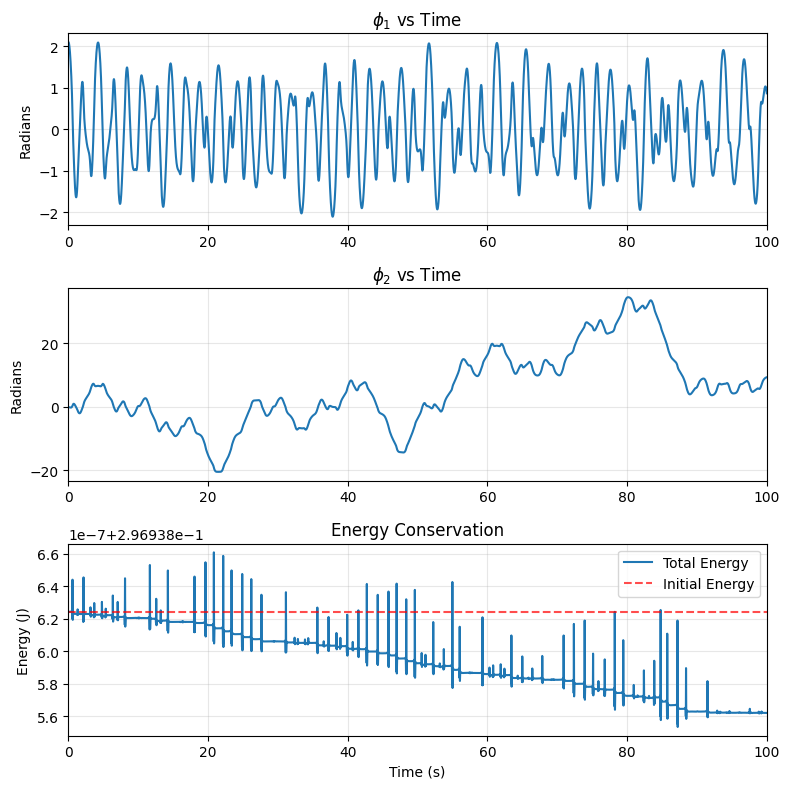

In [ ]:
%matplotlib inline
RK4_plot_only = RK_4()

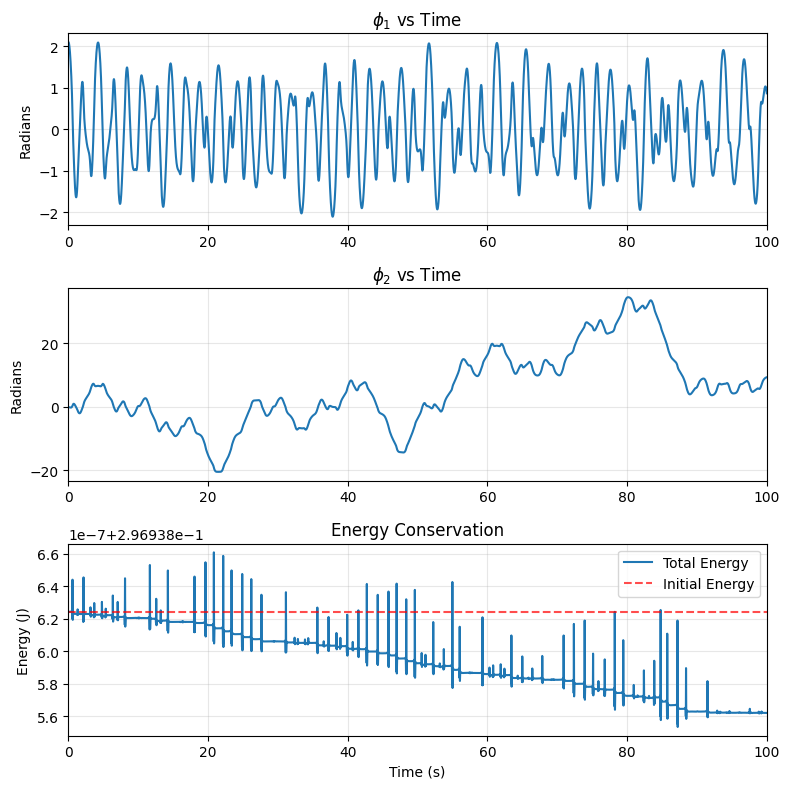

Shapes - t: (100000,), theta_1: (100000,), theta_2: (100000,), E: (100000,)


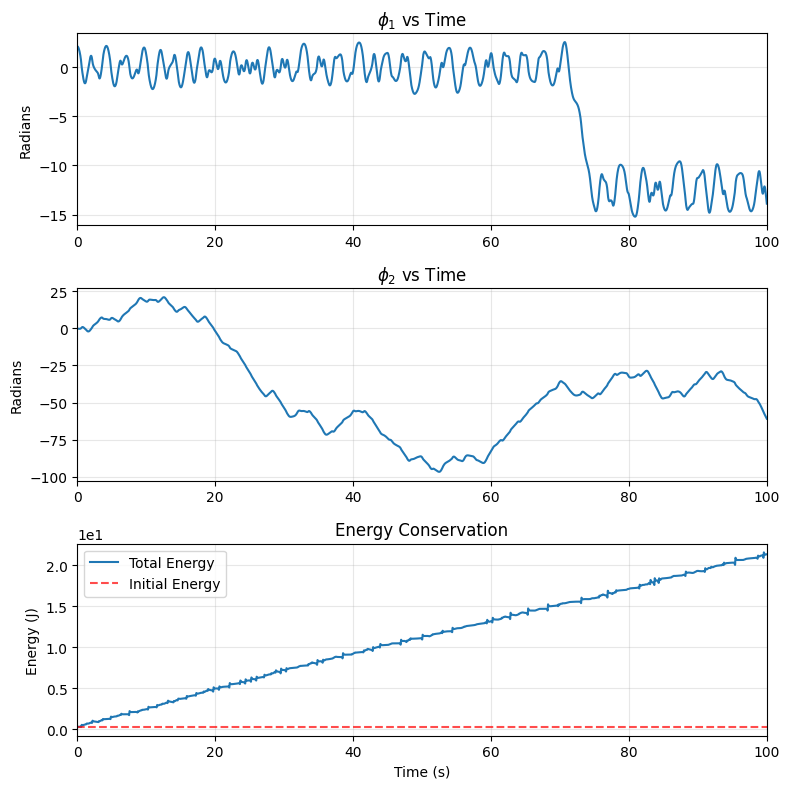

In [ ]:
y_rk4, E_rk4 = RK_4()  # For RK4 method
y_euler, E_euler = Euler()  # For Euler method

Kuramoto model testsss

Simulating coupled double pendulum lattice...
Final order parameter: 0.932
Mean order parameter (second half): 0.962
Maximum synchronization achieved: 0.997


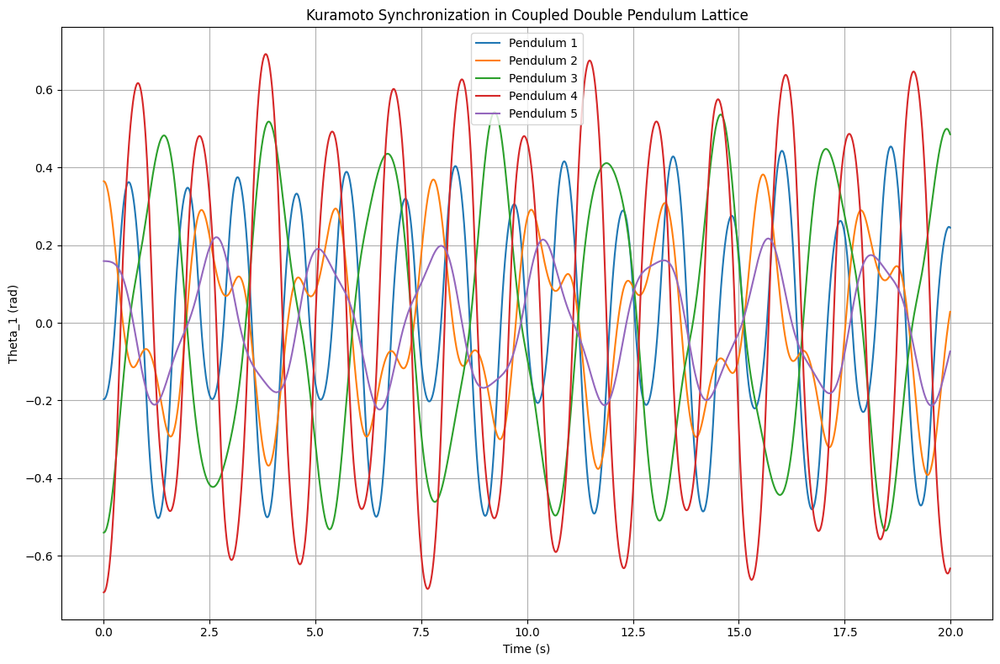

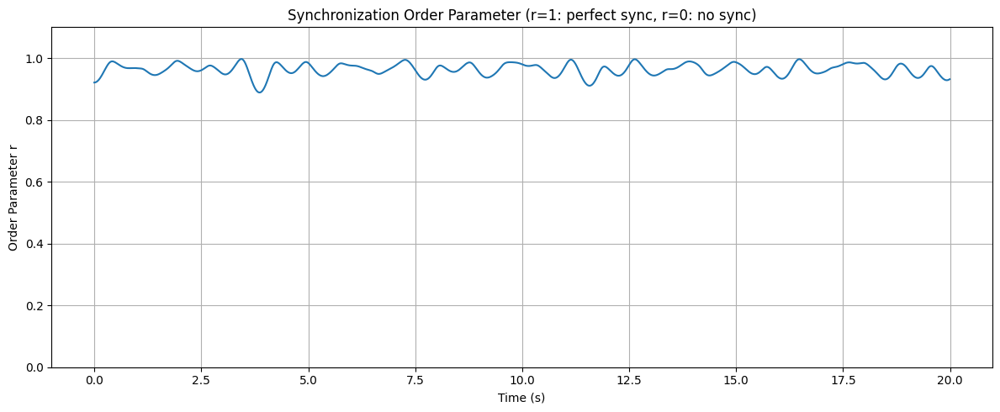

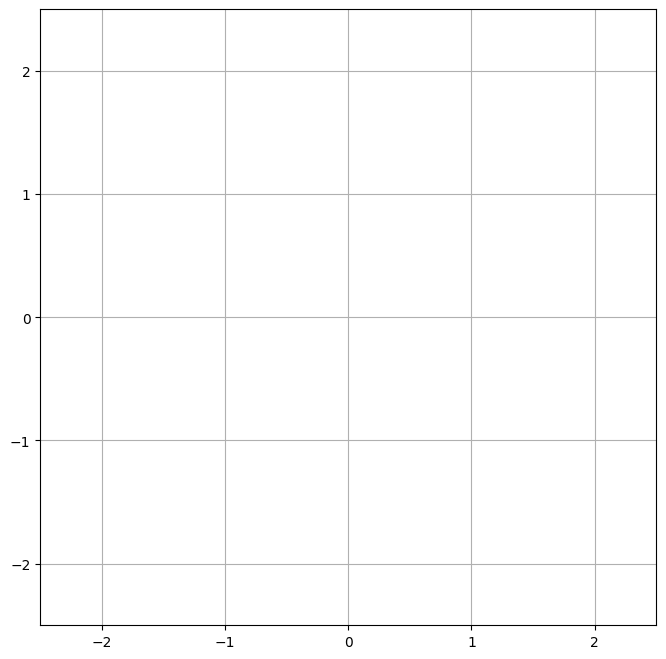

In [ ]:

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters (assuming these are already defined in your code)
# m1, m2 = 1.0, 1.0  
# l1, l2 = 1.0, 1.0  
# g = 9.81

# Coupling strength - controls synchronization behavior
K = 0.1  # Try different values (0.01 to 1.0) to see different dynamics

# Simulation parameters
t_end = 20
dt = 0.01
t = np.arange(0, t_end, dt)
N = len(t)

# Lattice setup
n_pendulums = 5
# Define network topology (which pendulums are connected)
# For ring topology: each pendulum connects to neighbors
connections = [(i, (i+1)%n_pendulums) for i in range(n_pendulums)]

# Initialize states with random initial conditions
np.random.seed(42)
initial_states = []
for i in range(n_pendulums):
    theta1 = np.random.uniform(-np.pi/4, np.pi/4)
    theta2 = np.random.uniform(-np.pi/4, np.pi/4)
    omega1 = 0.0
    omega2 = 0.0
    initial_states.append(np.array([theta1, theta2, omega1, omega2]))

def domega_coupled(states, t):
    """Calculate derivatives for all pendulums with coupling"""
    derivatives = []
    
    for i, state in enumerate(states):
        theta_1, theta_2, w1, w2 = state
        
        # Basic double pendulum dynamics from your existing functions
        c = 1 / (1 - alpha_1(theta_1, theta_2) * alpha_2(theta_1, theta_2))
        g1 = c * (f1(theta_1, theta_2, w2) - alpha_1(theta_1, theta_2) * f2(theta_1, theta_2, w1))
        g2 = c * (f2(theta_1, theta_2, w1) - alpha_2(theta_1, theta_2) * f1(theta_1, theta_2, w2))
        
        # Add Kuramoto coupling term
        coupling = 0.0
        for conn in connections:
            if i == conn[0]:
                j = conn[1]
                coupling += K * np.sin(states[j][0] - theta_1)
            elif i == conn[1]:
                j = conn[0]
                coupling += K * np.sin(states[j][0] - theta_1)
        
        # Add coupling to first angular acceleration (theta_1)
        g1 += coupling
        
        derivatives.append(np.array([w1, w2, g1, g2]))
    
    return derivatives

def RK4_step(states, t):
    """One step of RK4 integration for the coupled system"""
    k1_all = []
    derivatives = domega_coupled(states, t)
    for d in derivatives:
        k1_all.append(dt * d)
    
    # k2 calculation
    states_k2 = []
    for i, state in enumerate(states):
        states_k2.append(state + 0.5 * k1_all[i])
    derivatives = domega_coupled(states_k2, t + 0.5*dt)
    k2_all = [dt * d for d in derivatives]
    
    # k3 calculation
    states_k3 = []
    for i, state in enumerate(states):
        states_k3.append(state + 0.5 * k2_all[i])
    derivatives = domega_coupled(states_k3, t + 0.5*dt)
    k3_all = [dt * d for d in derivatives]
    
    # k4 calculation
    states_k4 = []
    for i, state in enumerate(states):
        states_k4.append(state + k3_all[i])
    derivatives = domega_coupled(states_k4, t + dt)
    k4_all = [dt * d for d in derivatives]
    
    # Combine to get new states
    new_states = []
    for i, state in enumerate(states):
        new_states.append(state + (1/6) * (k1_all[i] + 2*k2_all[i] + 2*k3_all[i] + k4_all[i]))
    
    return new_states

def simulate_coupled_lattice():
    """Run the full simulation"""
    # Initialize storage
    all_states = [[] for _ in range(n_pendulums)]
    
    # Set initial states
    current_states = initial_states.copy()
    
    # Run simulation
    for i in range(N):
        # Store current states
        for j in range(n_pendulums):
            all_states[j].append(current_states[j].copy())
        
        # Update states
        current_states = RK4_step(current_states, t[i])
    
    # Convert to numpy arrays
    all_states = [np.array(states) for states in all_states]
    return all_states

def order_parameter(all_states):
    """Calculate Kuramoto order parameter (measure of synchronization)"""
    # Extract theta_1 from all pendulums
    theta1_values = np.array([states[:, 0] for states in all_states])
    # Calculate complex order parameter
    complex_order = np.abs(np.mean(np.exp(1j * theta1_values), axis=0))
    return complex_order

def create_visualizations(all_states):
    # Plot theta_1 trajectories
    plt.figure(figsize=(12, 8))
    
    # Plot individual pendulum trajectories
    for i, states in enumerate(all_states):
        plt.plot(t, states[:, 0], label=f'Pendulum {i+1}')
    
    plt.xlabel('Time (s)')
    plt.ylabel('Theta_1 (rad)')
    plt.title('Kuramoto Synchronization in Coupled Double Pendulum Lattice')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.savefig('pendulum_sync.png', dpi=300)
    
    # Plot order parameter
    r = order_parameter(all_states)
    plt.figure(figsize=(12, 5))
    plt.plot(t, r)
    plt.xlabel('Time (s)')
    plt.ylabel('Order Parameter r')
    plt.title('Synchronization Order Parameter (r=1: perfect sync, r=0: no sync)')
    plt.ylim(0, 1.1)
    plt.grid(True)
    plt.tight_layout()
    
    # Create animation (optional)
    create_animation(all_states)

def create_animation(all_states):
    """Create an animation of the coupled pendulums"""
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_xlim(-2.5, 2.5)
    ax.set_ylim(-2.5, 2.5)
    ax.set_aspect('equal')
    ax.grid(True)
    
    # Calculate pendulum positions
    positions = []
    for states in all_states:
        x1 = l1 * np.sin(states[:, 0])
        y1 = -l1 * np.cos(states[:, 0])
        x2 = x1 + l2 * np.sin(states[:, 1])
        y2 = y1 - l2 * np.cos(states[:, 1])
        positions.append((x1, y1, x2, y2))
    
    # Create lines for visualization
    lines = []
    colors = plt.cm.viridis(np.linspace(0, 1, n_pendulums))
    
    for i in range(n_pendulums):
        # Position pendulums in a circle
        angle = 2 * np.pi * i / n_pendulums
        offset_x = 1.0 * np.cos(angle)
        offset_y = 1.0 * np.sin(angle)
        
        # Upper rod
        line1, = ax.plot([], [], 'o-', lw=2, color=colors[i])
        # Lower rod
        line2, = ax.plot([], [], 'o-', lw=2, color=colors[i])
        # Connection lines (for coupled pendulums)
        conn_lines = []
        for conn in connections:
            if i == conn[0] or i == conn[1]:
                conn_line, = ax.plot([], [], '--', lw=1, color='gray', alpha=0.5)
                conn_lines.append((conn, conn_line))
        
        lines.append((line1, line2, offset_x, offset_y, conn_lines))
    
    # Order parameter text
    r_text = ax.text(0.05, 0.95, '', transform=ax.transAxes)
    
    def init():
        for line1, line2, _, _, conn_lines in lines:
            line1.set_data([], [])
            line2.set_data([], [])
            for _, conn_line in conn_lines:
                conn_line.set_data([], [])
        r_text.set_text('')
        return [line1, line2, r_text]
    
    def update(frame):
        # Update pendulum positions
        for i, (line1, line2, offset_x, offset_y, conn_lines) in enumerate(lines):
            x1, y1, x2, y2 = positions[i]
            line1.set_data([offset_x, x1[frame] + offset_x], [offset_y, y1[frame] + offset_y])
            line2.set_data([x1[frame] + offset_x, x2[frame] + offset_x], 
                          [y1[frame] + offset_y, y2[frame] + offset_y])
        
        # Update connection lines
        for i, (_, _, offset_x, offset_y, conn_lines) in enumerate(lines):
            for (src, dst), conn_line in conn_lines:
                if i == src:
                    j = dst
                    x1_src, y1_src = positions[i][0][frame] + offset_x, positions[i][1][frame] + offset_y
                    x1_dst, y1_dst = positions[j][0][frame] + lines[j][2], positions[j][1][frame] + lines[j][3]
                    conn_line.set_data([x1_src, x1_dst], [y1_src, y1_dst])
        
        # Update order parameter
        r = order_parameter(all_states)[frame]
        r_text.set_text(f'Order Parameter: {r:.2f}')
        
        elements = [line1, line2, r_text]
        for _, _, _, _, conn_lines in lines:
            for _, conn_line in conn_lines:
                elements.append(conn_line)
        return elements
    
    anim = FuncAnimation(fig, update, frames=min(500, N), init_func=init, 
                          blit=True, interval=20)
    return anim

# Run simulation
print("Simulating coupled double pendulum lattice...")
all_states = simulate_coupled_lattice()
create_visualizations(all_states)

# Calculate and print synchronization metrics
r_final = order_parameter(all_states)[-1]
r_mean = np.mean(order_parameter(all_states)[N//2:])  # Mean of second half
print(f"Final order parameter: {r_final:.3f}")
print(f"Mean order parameter (second half): {r_mean:.3f}")
print(f"Maximum synchronization achieved: {np.max(order_parameter(all_states)):.3f}")


In [ ]:
# # Try various values to see transition to synchronization
# coupling_values = [0.01, 0.05, 0.1, 0.5, 1.0]
# results = {}
# for K in coupling_values:
#     print(f"Testing coupling strength K={K}")
#     # Run simulation with this K value...


In [ ]:
# Ring topology (already implemented)
ring_connections = [(i, (i+1)%n_pendulums) for i in range(n_pendulums)]

# All-to-all coupling
all_to_all = [(i, j) for i in range(n_pendulums) for j in range(i+1, n_pendulums)]

# Star topology (one central pendulum connected to all others)
star_connections = [(0, i) for i in range(1, n_pendulums)]

In [ ]:
# Parameters (identical for all pendulums)
g = 9.81
l1 = 1.0
l2 = 1.0
m1 = 1.0
m2 = 1.0
K = 0.05  # coupling strength
P = 5     # number of pendulums
T = 60.0
N = 1000
dt = T / N
t = np.linspace(0, T, N)

# --- Dynamics Functions ---

def alpha_1(theta_1, theta_2):
    return (l2 / l1) * (m2 / (m1 + m2)) * np.cos(theta_1 - theta_2)

def alpha_2(theta_1, theta_2):
    return (l1 / l2) * np.cos(theta_1 - theta_2)

def f1(theta_1, theta_2, w2):
    return -(l2 / l1) * (m2 / (m1 + m2)) * (w2 ** 2) * np.sin(theta_1 - theta_2) - (g / l1) * np.sin(theta_1)

def f2(theta_1, theta_2, w1):
    return (l1 / l2) * (w1 ** 2) * np.sin(theta_1 - theta_2) - (g / l2) * np.sin(theta_2)

def domega_lattice(Y, t):
    """
    Computes dY/dt for the coupled pendulum lattice
    Y is a 1D array of shape (P * 4,)
    Returns dYdt of the same shape
    """
    dYdt = np.zeros_like(Y)
    for i in range(P):
        idx = 4 * i
        theta_1, theta_2, w1, w2 = Y[idx:idx + 4]

        a1 = alpha_1(theta_1, theta_2)
        a2 = alpha_2(theta_1, theta_2)
        denom = 1 - a1 * a2
        g1 = (f1(theta_1, theta_2, w2) - a1 * f2(theta_1, theta_2, w1)) / denom
        g2 = (f2(theta_1, theta_2, w1) - a2 * f1(theta_1, theta_2, w2)) / denom

        # Coupling term for theta_1 with neighbors
        coupling = 0
        if i > 0:
            theta_1_prev = Y[4*(i-1)]
            coupling += np.sin(theta_1_prev - theta_1)
        if i < P - 1:
            theta_1_next = Y[4*(i+1)]
            coupling += np.sin(theta_1_next - theta_1)

        # Update the derivatives
        dYdt[idx]     = w1                   # dθ1/dt = ω1
        dYdt[idx + 1] = w2                   # dθ2/dt = ω2
        dYdt[idx + 2] = g1 + K * coupling    # dω1/dt (with coupling)
        dYdt[idx + 3] = g2                   # dω2/dt
    return dYdt

def RK_term(y, t, dt, f):
    k1 = dt * f(y, t)
    k2 = dt * f(y + 0.5 * k1, t + 0.5 * dt)
    k3 = dt * f(y + 0.5 * k2, t + 0.5 * dt)
    k4 = dt * f(y + k3, t + dt)
    return (1/6) * (k1 + 2 * k2 + 2 * k3 + k4)

# --- Initial Conditions ---
np.random.seed(42)
initial_thetas = np.random.uniform(low=0.0, high=np.pi/2, size=(P, 2))  # [theta1, theta2] for each
initial_omegas = np.zeros((P, 2))                                       # [omega1, omega2]
y0 = np.hstack([np.hstack([initial_thetas[i], initial_omegas[i]]) for i in range(P)])

# --- RK4 Integration ---
Y = [y0]
for i in range(1, N):
    Y.append(Y[-1] + RK_term(Y[-1], t[i-1], dt, domega_lattice))
Y = np.array(Y)  # shape (N, P*4)
Y.shape


(1000, 20)

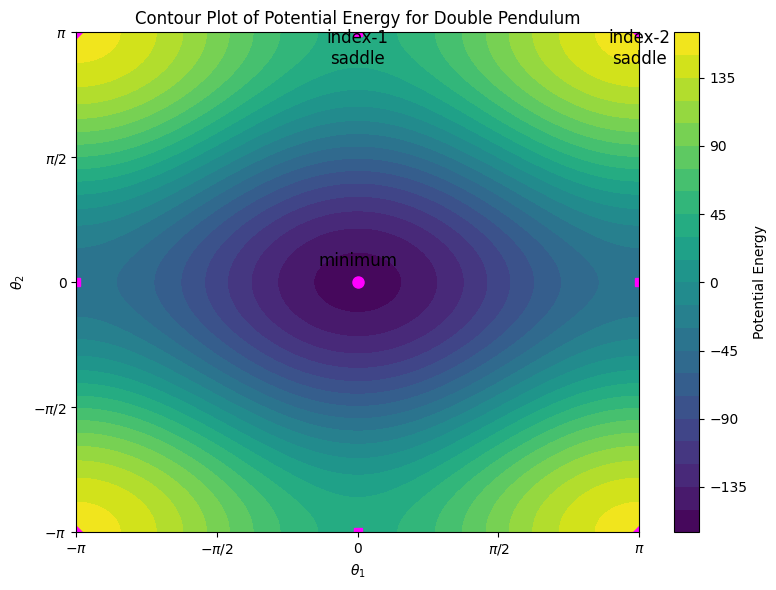

In [ ]:

# Constants
m1, m2 = 5.0, 1.0      # Masses
l1, l2 = 1.0, 10.0      # Lengths
g = 9.81               # Gravity

# Theta ranges
theta1 = np.linspace(-np.pi, np.pi, 300)
theta2 = np.linspace(-np.pi, np.pi, 300)

# Create meshgrid
Theta1, Theta2 = np.meshgrid(theta1, theta2)
%matplotlib inline
# Potential energy
V = -(m1 + m2)*g*l1*np.cos(Theta1) - m2*g*l2*np.cos(Theta2)

# Create contour plot
fig, ax = plt.subplots(figsize=(8, 6))
contour = ax.contourf(Theta1, Theta2, V, levels=30, cmap='viridis')
cbar = fig.colorbar(contour)
cbar.set_label('Potential Energy')

# Mark equilibrium points
ax.plot(0, 0, 'o', color='magenta', markersize=8)
ax.text(0, 0.2, 'minimum', fontsize=12, ha='center')

ax.plot(np.pi, 0, 's', color='magenta', markersize=6)
ax.plot(-np.pi, 0, 's', color='magenta', markersize=6)
ax.plot(0, np.pi, 's', color='magenta', markersize=6)
ax.plot(0, -np.pi, 's', color='magenta', markersize=6)
ax.text(0, np.pi - 0.4, 'index-1\nsaddle', fontsize=12, ha='center')

ax.plot(np.pi, np.pi, 'D', color='magenta', markersize=6)
ax.plot(-np.pi, np.pi, 'D', color='magenta', markersize=6)
ax.plot(np.pi, -np.pi, 'D', color='magenta', markersize=6)
ax.plot(-np.pi, -np.pi, 'D', color='magenta', markersize=6)
ax.text(np.pi, np.pi - 0.4, 'index-2\nsaddle', fontsize=12, ha='center')

# Axes labels and formatting
ax.set_xlabel(r'$\theta_1$')
ax.set_ylabel(r'$\theta_2$')
ax.set_xticks([-np.pi, -np.pi/2, 0, np.pi/2, np.pi])
ax.set_xticklabels([r'$-\pi$', r'$-\pi/2$', '0', r'$\pi/2$', r'$\pi$'])
ax.set_yticks([-np.pi, -np.pi/2, 0, np.pi/2, np.pi])
ax.set_yticklabels([r'$-\pi$', r'$-\pi/2$', '0', r'$\pi/2$', r'$\pi$'])
ax.set_title('Contour Plot of Potential Energy for Double Pendulum')

plt.tight_layout()
plt.show()


In [ ]:
def RK4_step(y, t, dt, domega):
    """
    Performs a single Runge-Kutta 4th order (RK4) integration step.

    Args:
        y: Current state vector (e.g., [theta1, omega1, theta2, omega2]).
        t: Current time.
        dt: Time step.
        domega: Function defining the system's time derivatives.

    Returns:
        y_next: State vector after one RK4 step.
    """
    k1 = domega(y, t)
    k2 = domega(y + 0.5 * dt * k1, t + 0.5 * dt)
    k3 = domega(y + 0.5 * dt * k2, t + 0.5 * dt)
    k4 = domega(y + dt * k3, t + dt)
    
    y_next = y + (dt / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
    return y_next


In [ ]:
def calculate_lyapunov_exponent(y0, dt, domega, epsilon=1e-6, n_steps=1000):
    y = np.copy(y0)
    y_perturbed = y0 + np.array([epsilon, 0, 0, 0])
    t = 0.0

    sum_log_divergence = 0.0

    for _ in range(n_steps):
        y_next = RK4_step(y, t, dt, domega)
        y_perturbed_next = RK4_step(y_perturbed, t, dt, domega)

        delta = y_perturbed_next - y_next
        dist = np.linalg.norm(delta)
        sum_log_divergence += np.log(dist / epsilon)

        delta_unit = delta / dist
        y_perturbed = y_next + epsilon * delta_unit
        y = y_next
        t += dt

    lyapunov_exponent = sum_log_divergence / (n_steps * dt)
    return lyapunov_exponent


In [ ]:
if __name__ == "__main__":
    y0 = np.radians([120, 0, -10, 0])
    dt = 0.01
    n_steps = 10000

    lyap = calculate_lyapunov_exponent(y0, dt, domega, epsilon=1e-8, n_steps=n_steps)
    print(f"Largest Lyapunov exponent: {lyap:.6f}")
    

Largest Lyapunov exponent: 0.939170
